## Our Election Model
Now that we have built our features, we will use our dataset to create, test, and tune a number of potential models to predict Democratic or Republican counties.

Since our data indicates number of stores, we have ordinal data.  We could use dummy variables to make it categorical data, but this would make for an extremely large number of features.  Instead, we will calculate the number of stores per population, so that we are working with stores/person instead of integer stores.  This should make the data essentially continuous.

We start by reading in our data we wrote to file from the feature building notebook and making those small modifications.

We saved data for house races (US Congressional seats), major races (national and statewide races), and all races (local, state, and national).   Using all races improved the model by about 3% over the other datasets.

## Importing and cleaning data

In order to make the features contiunous instead of ordinal, I chose to divide each store column by the area or popultion of the county.  I ended up using population so I could also apply the model to the district 

I also made a df_raw dataframe so that I could have an unaltered df later in the code.

In [100]:
import pickle
import pandas as pd

# import data
# open the dataset of your choice (major_df, house_df, all_df)
with open('datasets/all_df.pkl', 'rb') as f:
    df = pickle.load(f)
    
with open('datasets/district_stores_df.pkl', 'rb') as f:
    dist_df = pickle.load(f)
    

dist_df = dist_df.drop(columns=['Unnamed: 0'], axis=1)
df_raw = df.copy()  # saving an unaltered copy for later

#one last bit of feature engineering
#change data to be stores per 10k people
# revised to be per area
for col in df.columns:
    if col in ['state_fips', 'county', 'party', 'candidatevotes', 'fips', 'blue', 'population', 'area']:
        continue
    df[col] = df[col] / df['population']
    
# do same for house districts
dist_population = 711000
for col in dist_df.columns:
    if col in ['district', 'party', 'blue']:
        continue
    dist_df[col] = dist_df[col].apply(lambda x: x / dist_population)   
    
    

df = df.drop(columns=['index'], axis=1)
pd.set_option('display.max_columns', None)
#df.isna().sum()  # It worked!
df = df.dropna()

df = df.rename({'ChickFila': 'ChickFilA'}, axis=1)

# Now we have df and df_dist ready to go

# do same for binary
#df_raw = df.drop(columns=['index'], axis=1)
df_raw = df_raw.dropna()
df_raw = df_raw.rename({'ChickFila': 'ChickFilA'}, axis=1)



In [101]:
df.head()

,state_fips,county,party,candidatevotes,totalvotes,fips,blue,WholeFoods,TractorSupply,Starbucks,AcademySports,DicksSports,BassPro,DollarTree,Grainger,ChickFilA,CrackerBarrel,HarleyDavidson,HM,HobbyLobby,LLBean,PotteryBarn,REI,Target,TraderJoes,Walmart,Costco,population,area
1,1,AUTAUGA,republican,225013.0,1299.198909,01001,0,0.0,0.000000,0.000018,0.000000,0.000000,0.000000,0.000018,0.0,0.000018,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000018,0.0,55533,594.436
3,1,BALDWIN,republican,886133.0,331.176301,01003,0,0.0,0.000014,0.000023,0.000005,0.000005,0.000005,0.000037,0.0,0.000014,0.000009,0.0,0.000005,0.000009,0.0,0.000005,0.0,0.000009,0.0,0.000028,0.0,217855,1589.784
5,1,BARBOUR,republican,66244.0,2900.788557,01005,0,0.0,0.000040,0.000000,0.000000,0.000000,0.000000,0.000040,0.0,0.000040,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000040,0.0,24872,884.876
7,1,BIBB,republican,88177.0,3225.663388,01007,0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000045,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000045,0.0,22367,622.582
9,1,BLOUNT,republican,257928.0,1248.869035,01009,0,0.0,0.000017,0.000000,0.000000,0.000000,0.000000,0.000017,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000017,0.0,57771,644.776


## Import my libraries

In [102]:
import xgboost as xgb

# had difficutly with path for xgb
# THIS WORKED. Save this info for later, it installs directly.
# import sys
# !{sys.executable} -m pip install xgboost

In [103]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score


import warnings
warnings.filterwarnings('ignore')



## Make the X, y data for model (for both county and district)

I used only 10 features chosen during Boruta feature selection (bottom of notebook).  drop_cols contained the features selected for removal.

In [104]:
# I am choosing to train on the 3000+ counties in the USA, and test on the 435 congressional districts 
# to predict the congressional race for 2018

# Make my X and y data  AND FEATURE SELECTION
y = df['blue']
y_dist = dist_df['blue']

extra_cols = ['totalvotes', 
              'county', 
              'party', 
              'fips', 
              'state_fips', 
              'candidatevotes', 
              'blue',
              'population',
              'area',
             ]

extra_cols_dist = ['party', 'blue', 'district']

drop_cols = ['AcademySports',
             'BassPro',
             'CrackerBarrel',
             'LLBean',
             'PotteryBarn',
             'REI',
             'DicksSports',
             'Grainger',
             'ChickFilA',
             'HarleyDavidson',
            ]

# experimental data for later

# dem_cols = ['TraderJoes',
#             'Costco',
#             'Starbucks',
#             'HM',
#             'Target',
#             'WholeFoods'
#            ]  

# gop_cols = ['TractorSupply',
#             'HobbyLobby',
#             'Walmart',
#             'DollarTree'
#             ]

X = df.drop(columns=extra_cols+drop_cols)  # + drop_cols when you want to drop multiples
X_dist = dist_df.drop(columns=extra_cols_dist+drop_cols)


# get my cols to line up
X_dist = X_dist[X.columns]

In [105]:
df['blue'].sum()
df['party'].value_counts()  # vals are same.  Just verification

republican    2496
democrat       607
Name: party, dtype: int64

# Train/test split
I experimented with a test size of 0.2 and 0.25 and it made little difference in model performance.

In [106]:
# Scale my data (not done for the types of models used here)
# scaler = StandardScaler()
# X_scaled = scaler.fit_transform(X)

In [107]:
# Split my data

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=0)


# XGBoost model
Create a baseline model.  Importantly, this model uses no weighting which greatly improves the accuracy but results in many False Negatives for Democratic party.  We don't catch as many of the minority class.

In [108]:
# We will skip scaling of the data.  It is already all in the same units (stores per 10k population)
# The data is very homogenous at this point

# after we do the model, we can trim the fat.  Not all stores will be important.

# MAKE A BASELINE MODEL
xg_clf = xgb.XGBClassifier()
xg_clf.fit(X_train, y_train)

# Make predictions and measure accuracy
training_preds = xg_clf.predict(X_train)
val_preds = xg_clf.predict(X_test)

training_accuracy = accuracy_score(y_train, training_preds)
val_accuracy = accuracy_score(y_test, val_preds)

print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))

Training Accuracy: 87.19%
Validation accuracy: 85.99%


### XGBoost Model Tuning
A lot of tuning was done using a GridSearch.  The final numbers in the param_grid were for troubleshooting and final tuning.  The ones in comments show what others wer tried during tuning.

In [109]:
# TUNING
param_grid = {
    "learning_rate": [0.01],   # 0.1, 0.01, 0.03, 0.04
    'n_estimators': [1000],  # 1000, 500, 250
    'max_depth': [6], # prevent over/under fitting 4 to 9
    'min_child_weight': [0.3],
    'colsample_bytree':[0.9],  # tried 0.5 to 1
    #'subsample': [0.85],
    #'gamma': [0],  # did not affect
    'scale_pos_weight': [2], # 1 to 4
    'random_state': [0]
}

In [110]:
grid_clf = GridSearchCV(xg_clf, param_grid, scoring='accuracy', cv=5, n_jobs=1)
grid_clf.fit(X_train, y_train)

best_parameters = grid_clf.best_params_

print("Grid Search found the following optimal parameters: ")
for param_name in sorted(best_parameters.keys()):
    print("%s: %r" % (param_name, best_parameters[param_name]))

training_preds = grid_clf.predict(X_train)
val_preds = grid_clf.predict(X_test)
training_accuracy = accuracy_score(y_train, training_preds)
val_accuracy = accuracy_score(y_test, val_preds)

print("")
print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))

Grid Search found the following optimal parameters: 
colsample_bytree: 0.9
learning_rate: 0.01
max_depth: 6
min_child_weight: 0.3
n_estimators: 1000
random_state: 0
scale_pos_weight: 2

Training Accuracy: 91.94%
Validation accuracy: 85.19%


## XGBoost Final Model

In [111]:
# Decision Tree
import pandas as pd
import numpy as np
np.random.seed(0)
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier

# MAKE A BASELINE MODEL
xg_final = xgb.XGBClassifier(learning_rate=0.03,
                             n_estimators=500,
                             max_depth=5,
                             min_child_weight=0.5,  # higher is more conservative
                             colsample_bytree=0.9,
                             scale_pos_weight=3,
                             random_state=0,
                            )

xg_final.fit(X_train, y_train)

# Make predictions and measure accuracy
training_preds = xg_final.predict(X_train)
val_preds = xg_final.predict(X_test)

training_accuracy = accuracy_score(y_train, training_preds)
val_accuracy = accuracy_score(y_test, val_preds)

print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))

Training Accuracy: 91.66%
Validation accuracy: 84.54%


The XGBoost model performed very well as a baseline.  When weighted for the imbalance of the dataset, it began to lose the high accuracy.  The peak performance of the model was 88.5%, but without any weighting.  Under these conditions, the model missed far too many Democratic counties to be a useful predictive model.

## Confusion matrix (XGBoost)

[[471  33]
 [ 63  54]]


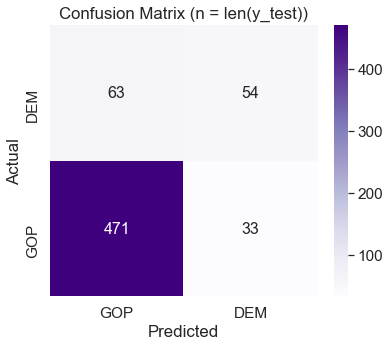

(0.8327858542638793, 0.8454106280193237, 0.8362777128946578, None)

In [112]:
import pandas as pd
import seaborn as sn
import matplotlib.pyplot as plt
%matplotlib inline
import itertools
import matplotlib.pyplot as plt 
from sklearn.metrics import precision_recall_fscore_support


#plot_feature_importances(forest)
cm = confusion_matrix(y_test, xg_final.predict(X_test))
#cm = cm/cm.sum()*100  # makes it a percentage if you want
#cm = cm.round(1)
print(cm)



fig, ax = plt.subplots(figsize = (6,5))
sn.set_context('poster')
sn.set(font_scale=1.4)#for label size
sn.heatmap(cm, cmap="Purples", annot=True, fmt='g', annot_kws={"size": 16})# font size

plt.title("Confusion Matrix (n = len(y_test))")
plt.xlabel('Predicted')
plt.ylabel('Actual')
# Hide major tick labels


# Customize minor tick labels
plt.xticks([0.5, 1.5], ['GOP','DEM'])
plt.yticks([0.5, 1.5], ['GOP','DEM'])
ax.set_ylim([0,2])
ax.set_xlim([0,2])


#plt.annotate("GOP: 0, DEM: 1", [1.5,0.1], fontsize=10)

plt.show()
# worked with other environment


# accuracy 
precision_recall_fscore_support(y_test, xg_final.predict(X_test), average='weighted')

This confusion matrix shows a pretty good balance between false negatives and positives.  We sacrificed a lot of accuracy to achieve that balance.  If we focus on only maximizing 

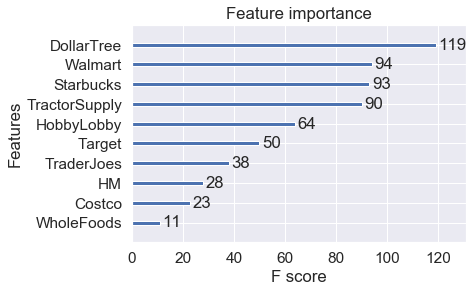

In [113]:
# plot feature importance
xgb.plot_importance(xg_clf)

It is perhaps important to note that the stores with the most chains top the list of important features.  Also, the four of the top five most important features are assumed 'red' county features.  The model *may* be picking out Repulican counties based on these features.

# Decision Tree and Random Forest

### Baseline Decision Tree
Start with a simple decision tree and score it to see how we do without tuning.

In [114]:
def plot_feature_importances(model):
    n_features = X_train.shape[1]
    plt.figure(figsize=(8,8))
    plt.barh(range(n_features), model.feature_importances_, align='center', color='purple') 
    plt.yticks(np.arange(n_features), X_train.columns.values) 
    plt.xlabel('Feature importance')
    plt.ylabel('Feature')

In [115]:
# Decision Tree
import pandas as pd
import numpy as np
np.random.seed(0)
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier

In [116]:
# Instantiate and fit a DecisionTreeClassifier
#np.random.seed(337)

tree_clf = DecisionTreeClassifier() 
tree_clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

After investigating a number of simple decision trees, it became obvious that Trader Joe's was by far the most important feature in single trees.  The presence of a Trader Joe's in a voting district alone is good for 82% prediction rate by itself.  After looking at a number of individual Decision Trees, they mostly had accuracies from 78% to 85%.

In [117]:
from sklearn.metrics import accuracy_score

training_preds = tree_clf.predict(X_train)
val_preds = tree_clf.predict(X_test)
training_accuracy = accuracy_score(y_train, training_preds)
val_accuracy = accuracy_score(y_test, val_preds)

print("")
print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))


Training Accuracy: 95.37%
Validation accuracy: 80.35%


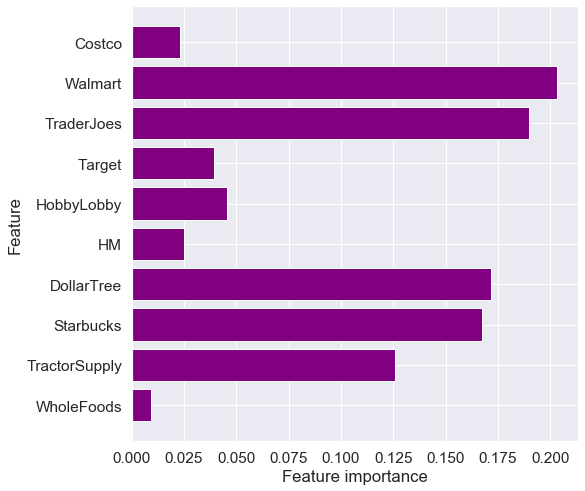

In [118]:
plot_feature_importances(tree_clf)

## Random Forest

In [119]:
import pandas as pd
import numpy as np
np.random.seed(1)
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier

### Random Forest Tuning
We will create a random forest classifier, and tune it for accuracy.

In [120]:
# Instantiate random forest
forest = RandomForestClassifier()

In [121]:
# TUNING
rf_param_grid = {
    'n_estimators': [1000, 700, 500],
    'criterion': ['gini', 'entropy'],
    #'max_depth': [3,4,5,6],
    #'min_samples_split': [3,4,5,6,7],
    #'min_samples_leaf': [4,5,6],
    'class_weight': [{0:1, 1:2}]
}


# This was used for fine tuning
rf_param_grid = {
    'n_estimators': [700],
    'criterion': ['entropy'],
    'max_depth': [6],
    'min_samples_split': [10],
    'min_samples_leaf': [5],
    'random_state': [0],
    #'class_weight': [{0:1, 1:3}]
    'class_weight': ['balanced']
}

In [122]:
grid_clf = GridSearchCV(forest, rf_param_grid, scoring='accuracy', cv=5, n_jobs=1)
grid_clf.fit(X_train, y_train)

best_parameters = grid_clf.best_params_

print("Grid Search found the following optimal parameters: ")
for param_name in sorted(best_parameters.keys()):
    print("%s: %r" % (param_name, best_parameters[param_name]))

training_preds = grid_clf.predict(X_train)
val_preds = grid_clf.predict(X_test)
training_accuracy = accuracy_score(y_train, training_preds)
val_accuracy = accuracy_score(y_test, val_preds)

print("")
print("Training Accuracy: {:.4}%".format(training_accuracy * 100))
print("Validation accuracy: {:.4}%".format(val_accuracy * 100))

Grid Search found the following optimal parameters: 
class_weight: 'balanced'
criterion: 'entropy'
max_depth: 6
min_samples_leaf: 5
min_samples_split: 10
n_estimators: 700
random_state: 0

Training Accuracy: 84.81%
Validation accuracy: 83.41%


## Random Forest Model


In [123]:
# Instantiate and fit a RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score


forest = RandomForestClassifier(criterion='entropy',
                                max_depth=5,
                                #max_features=5,
                                min_samples_leaf=5,
                                min_samples_split=15,
                                n_estimators=250,
                                random_state=337,
                                #class_weight='balanced',
                                class_weight={1:3},
                               )  # tuned for population

# forest = RandomForestClassifier(criterion='entropy',
#                                 max_depth=5,
#                                 #max_features=5,
#                                 min_samples_leaf=3,
#                                 min_samples_split=10,
#                                 n_estimators=200,
#                                 random_state=0,
#                                 #class_weight='balanced',
#                                 class_weight={1:3},
#                                ) # tuned for area

forest.fit(X_train, y_train)
mean_rf_cv_score_train = np.mean(cross_val_score(forest, X_train, y_train, cv=5))
mean_rf_cv_score = np.mean(cross_val_score(forest, X_test, y_test, cv=5))

print(f"Mean Cross Validation Score for Random Forest Classifier Train: {mean_rf_cv_score_train :.2%}")
print(f"Mean Cross Validation Score for Random Forest Classifier Test: {mean_rf_cv_score :.2%}")

Mean Cross Validation Score for Random Forest Classifier Train: 83.24%
Mean Cross Validation Score for Random Forest Classifier Test: 85.34%


[[462  42]
 [ 56  61]]


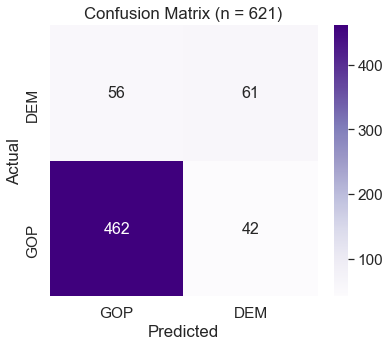

(0.8327858542638793, 0.8454106280193237, 0.8362777128946578, None)

In [124]:
cm = confusion_matrix(y_test, forest.predict(X_test))
#cm = cm/cm.sum()*100  # makes it a percentage if you want
#cm = cm.round(1)
print(cm)



fig, ax = plt.subplots(figsize = (6,5))
sn.set_context('poster')
sn.set(font_scale=1.4)#for label size
sn.heatmap(cm, cmap="Purples", annot=True, fmt='g', annot_kws={"size": 16})# font size

plt.title("Confusion Matrix (n = {})".format(len(y_test)))
plt.xlabel('Predicted')
plt.ylabel('Actual')
# Hide major tick labels


# Customize minor tick labels
plt.xticks([0.5, 1.5], ['GOP','DEM'])
plt.yticks([0.5, 1.5], ['GOP','DEM'])
ax.set_ylim([0,2])
ax.set_xlim([0,2])


#plt.annotate("GOP: 0, DEM: 1", [1.5,0.1], fontsize=10)

plt.show()
# worked with other environment


# accuracy 
precision_recall_fscore_support(y_test, xg_final.predict(X_test), average='weighted')

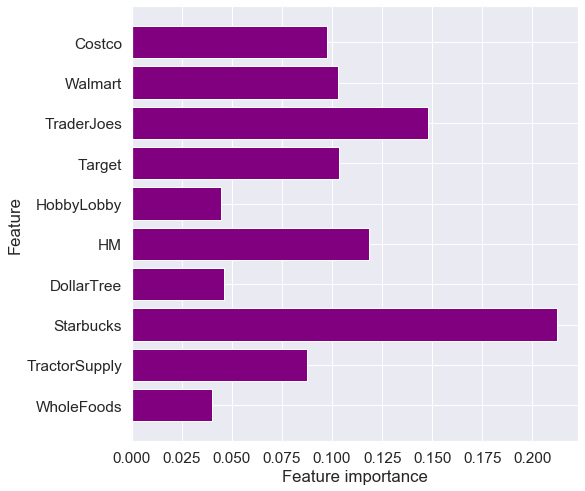

In [125]:
plot_feature_importances(forest)


## Decision Tree Visualization

I wanted to see what was happening inside individual trees, so I mades a visualization of a single decision tree to see how each feature was being used in the model.  

It is important to note that you cannot actually determine the 'direction' of a feature, but you can look at trees and see how they are being used in a particular model.  When we say a feature is 'red' or 'blue', we are generalizing based on observation, and making an assumption.

In [126]:
# in case you need the libraries

# !conda install pydotplus --yes
# !conda install graphviz --yes

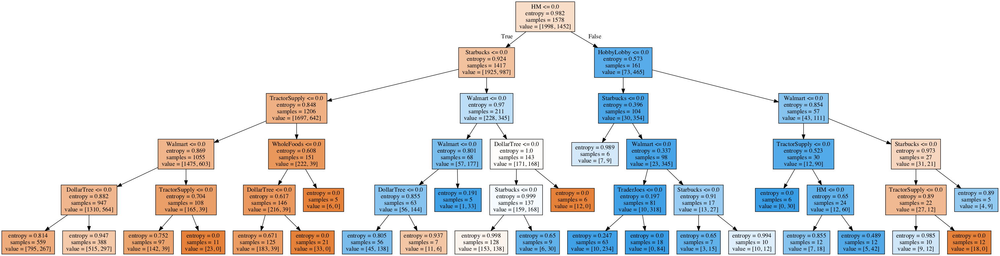

In [127]:
# Load libraries
from sklearn.tree import DecisionTreeClassifier
from sklearn import datasets
from IPython.display import Image  
from sklearn import tree
import pydotplus
import collections



estimator = forest.estimators_[5]  # change the index here to look at different trees

# Create DOT data
dot_data = tree.export_graphviz(estimator, 
                                out_file=None, 
                                filled=True,
                                feature_names=X.columns,  
                               )

# Draw graph
graph = pydotplus.graph_from_dot_data(dot_data)  



# Show graph
Image(graph.create_png())

From examining trees, we learn that typically the following is accurate:
- Democratic features - StarBucks, Whole Foods, Target, H&M, Costco, Trader Joes
- Republican features - Tractor Supply, Hobby Lobby, Walmart, Dollar Tree

In [129]:
import plotly.express as px
from urllib.request import urlopen
import json


def make_choro(df, geojson, col, color_list, range_color):
    fig = px.choropleth(df, 
                        geojson=geojson, 
                        locations='fips', 
                        color=col,
                        #color_discrete_sequence=px.colors.qualitative.Set1,
                        color_continuous_scale=color_list,
                        range_color=range_color,
                        scope="usa",
            #                     labels={'WholeFoods':'Whole Foods',
            #                             'county': 'County'},
                        hover_name='county',
                        hover_data=[col, 'party'],
                    )
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.show()

with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    us_county_fix = json.load(response)

The following adds a column for misses.  These are counties where we got it wrong (FP or FN).

In [132]:
import plotly.express as px
df['pred'] = forest.predict(X)

df['misses'] = df['pred'] + df['blue']
df['misses'] = df['misses'].apply(lambda x: 0 if x%2==0 else 1)

The code below maps our model results for counties.

In [133]:
#make_choro(df, us_county_fix, 'pred', ['red', 'blue'], [0, 1])
#make_choro(df, us_county_fix, 'blue', ['red', 'blue'], [0, 1])
make_choro(df, us_county_fix, 'misses', ['white', 'purple'], [0, 1])

## Try our model on congressional districts
It would be interesting to apply our model to congressional districts to see how it translates.  Since the model uses stores/population, it should be in same units.  District data is much more balanced.  

In [134]:
import geopandas as gpd

finalvotes_df = pd.read_pickle('datasets/finalvotes_df.pkl')
dist_df = pd.read_pickle('datasets/district_stores_df.pkl')

In [135]:
# MAKE A GEOPANDAS DF
# load my geojson file which contains my Polygons
boundary_file = "datasets/dist3.geojson"
geo_data = gpd.read_file(boundary_file)   


abbrev_dict = {
    'Alabama': 'AL',
    'Alaska': 'AK',
    'American Samoa': 'AS',
    'Arizona': 'AZ',
    'Arkansas': 'AR',
    'California': 'CA',
    'Colorado': 'CO',
    'Connecticut': 'CT',
    'Delaware': 'DE',
    'District of Columbia': 'DC',
    'Florida': 'FL',
    'Georgia': 'GA',
    'Guam': 'GU',
    'Hawaii': 'HI',
    'Idaho': 'ID',
    'Illinois': 'IL',
    'Indiana': 'IN',
    'Iowa': 'IA',
    'Kansas': 'KS',
    'Kentucky': 'KY',
    'Louisiana': 'LA',
    'Maine': 'ME',
    'Maryland': 'MD',
    'Massachusetts': 'MA',
    'Michigan': 'MI',
    'Minnesota': 'MN',
    'Mississippi': 'MS',
    'Missouri': 'MO',
    'Montana': 'MT',
    'Nebraska': 'NE',
    'Nevada': 'NV',
    'New Hampshire': 'NH',
    'New Jersey': 'NJ',
    'New Mexico': 'NM',
    'New York': 'NY',
    'North Carolina': 'NC',
    'North Dakota': 'ND',
    'Northern Mariana Islands':'MP',
    'Ohio': 'OH',
    'Oklahoma': 'OK',
    'Oregon': 'OR',
    'Pennsylvania': 'PA',
    'Puerto Rico': 'PR',
    'Rhode Island': 'RI',
    'South Carolina': 'SC',
    'South Dakota': 'SD',
    'Tennessee': 'TN',
    'Texas': 'TX',
    'Utah': 'UT',
    'Vermont': 'VT',
    'Virgin Islands': 'VI',
    'Virginia': 'VA',
    'Washington': 'WA',
    'West Virginia': 'WV',
    'Wisconsin': 'WI',
    'Wyoming': 'WY',
    'District Of Columbia': 'DC',
}

codes = []

# Make the codes in geo and df match
geo_data['DISTRICT'] = geo_data['DISTRICT'].apply(lambda x: '1' if x=='0' else x)



for i in range(len(geo_data)):
    code = '{}-{:02}'.format(abbrev_dict[geo_data.iloc[i]['STATENAME']], int(geo_data.iloc[i]['DISTRICT']))
    codes.append(code)
    
geo_data['Code'] = codes
#geo_data['DISTRICT'] = geo_data['DISTRICT'].apply(lambda x: str(x))

finalvotes_df.iloc[:]['Code'] = finalvotes_df['district']
finalvotes_df['district'] = finalvotes_df['district'].apply(lambda x: str(x))

geo_data.head()

,STATENAME,ID,DISTRICT,STARTCONG,ENDCONG,DISTRICTSI,COUNTY,PAGE,LAW,NOTE,BESTDEC,FINALNOTE,RNOTE,LASTCHANGE,FROMCOUNTY,geometry,Code
0,Louisiana,022113114006,6,113,114,,,,,,,"{""From US Census website""}",,2016-05-29T16:44:10.857626,False,"POLYGON ((-90.57000 30.53000, -90.57000 30.540...",LA-06
1,Maine,023113114001,1,113,114,,,,,,,"{""From US Census website""}",,2016-05-29T16:44:10.857626,False,"MULTIPOLYGON (((-70.99000 43.79000, -70.99000 ...",ME-01
2,Maine,023113114002,2,113,114,,,,,,,"{""From US Census website""}",,2016-05-29T16:44:10.857626,False,"MULTIPOLYGON (((-67.20000 44.91000, -67.19000 ...",ME-02
3,Maryland,024113114001,1,113,114,,,,,,,"{""From US Census website""}",,2016-05-29T16:44:10.857626,False,"MULTIPOLYGON (((-77.22000 39.72000, -77.21000 ...",MD-01
4,Maryland,024113114002,2,113,114,,,,,,,"{""From US Census website""}",,2016-05-29T16:44:10.857626,False,"MULTIPOLYGON (((-76.63000 39.27000, -76.64000 ...",MD-02


In [136]:
y_pred = forest.predict(X_dist)
dist_df['pred'] = y_pred

accuracy = accuracy_score(y_dist, y_pred)

print("")
print("District Accuracy: {:.4}%".format(accuracy * 100))



District Accuracy: 72.87%


In [137]:

import folium


import folium
import json
import numpy as np
import branca.colormap as cm

# create a LinearColorMap and assign colors, vmin, and vmax
# the colormap will show green for $100,000 homes all the way up to red for $1,500,000 homes
colormap = cm.LinearColormap(colors=['red', 'blue'], vmin=0, vmax=1)


center= (39.8283, -98.5795,)

def my_color_function(feature):
    """Maps low values to red and high values to blue."""
    if feature == 1:
        return '#0000FF'
    else:
        return '#FF0000'

def folium_del_legend(choropleth: folium.Choropleth):
  """A hack to remove choropleth legends.
  
  The choropleth color-scaled legend sometimes looks too crowded. Until there is an
  option to disable the legend, use this routine to remove any color map children
  from the choropleth.
  
  Args:
    choropleth: Choropleth objected created by `folium.Choropleth()`
    
  Returns:
    The same object `choropleth` with any child whose name starts with
    'color_map' removed.
  """
  del_list = []
  for child in choropleth._children:
    if child.startswith('color_map'):
      del_list.append(child)
  for del_item in del_list:
    choropleth._children.pop(del_item)
  return choropleth
    
    
# Initialize Folium Map again (same as before)
m = folium.Map(location=center, 
               zoom_start=4,
               tiles='Stamen Toner')


# Create choropleth map  

folium_del_legend(folium.Choropleth(
    geo_data=geo_data,
    name='choropleth',
    data=dist_df,
    columns=['district', 'pred'],
    key_on='feature.properties.Code', 
    fill_color='Spectral',
    line_width=1,
    fill_opacity=0.6,
    #nan_fill_opacity=0,
    #line_opacity=1,
    #legend_name='Stores',
).add_to(m))



m

## Additional caluclation for presentation and write up

First we will calculate how many of each store lie in Dem/GOP counties.

In [138]:

def how_dem(df, col):
    '''
    Calculates the percent of Stores in Democratic and Republican counties
    
    Parameters:
    df(DataFrame): store/feature dataframe
    col(str): column we are looking at
    
    Return:
    col(str): repeat back the column passed in
    dem(float): percent Democratic
    1-dem(float): percent Republican
    '''
    grouped_df = df[[col, 'blue']].groupby(col).count() 
    dem = grouped_df.iloc[0]['blue'] / grouped_df.reset_index()['blue'].sum()
    print("{}:\n\t{:.1f}% in Dem counties.\n\t{:.1f}% in GOP counties.\n"
          .format(col, dem*100, (1-dem)*100))
    return col, dem, (1-dem)
    
store_lean = []    

for col in df_raw.columns: 
    if col not in extra_cols + ['index']:
        store_lean.append(how_dem(df_raw, col))
        

WholeFoods:
	93.3% in Dem counties.
	6.7% in GOP counties.

TractorSupply:
	55.9% in Dem counties.
	44.1% in GOP counties.

Starbucks:
	65.1% in Dem counties.
	34.9% in GOP counties.

AcademySports:
	94.5% in Dem counties.
	5.5% in GOP counties.

DicksSports:
	85.0% in Dem counties.
	15.0% in GOP counties.

BassPro:
	97.6% in Dem counties.
	2.4% in GOP counties.

DollarTree:
	40.4% in Dem counties.
	59.6% in GOP counties.

Grainger:
	91.4% in Dem counties.
	8.6% in GOP counties.

ChickFilA:
	77.2% in Dem counties.
	22.8% in GOP counties.

CrackerBarrel:
	83.7% in Dem counties.
	16.3% in GOP counties.

HarleyDavidson:
	79.9% in Dem counties.
	20.1% in GOP counties.

HM:
	90.1% in Dem counties.
	9.9% in GOP counties.

HobbyLobby:
	79.3% in Dem counties.
	20.7% in GOP counties.

LLBean:
	98.4% in Dem counties.
	1.6% in GOP counties.

PotteryBarn:
	95.8% in Dem counties.
	4.2% in GOP counties.

REI:
	96.3% in Dem counties.
	3.7% in GOP counties.

Target:
	79.5% in Dem counties.
	20.5% in G

Plot the leaning of each store using bar graph.

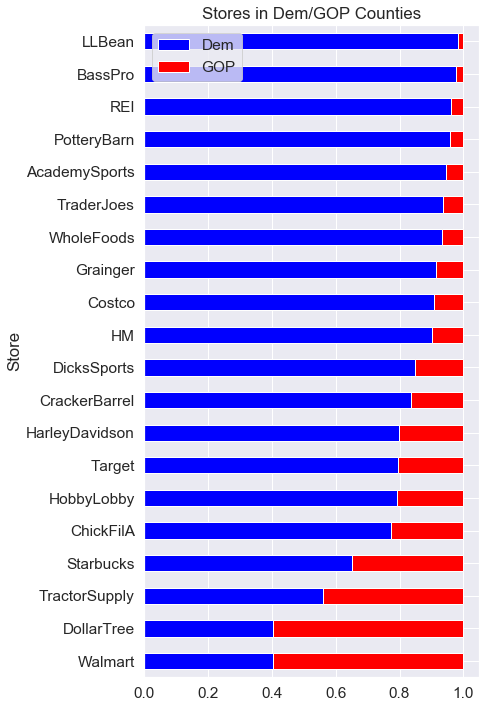

In [139]:
store_lean = sorted(store_lean, key=lambda x: x[1])
store_plot = pd.DataFrame(store_lean)
store_plot.columns = ['Store', 'Dem', 'GOP']

store_plot['TotalStores'] = store_plot['Store'].apply(lambda x: df_raw[x].sum())


ax = store_plot.plot(x='Store', 
                y={'Dem':'Dem', 'GOP':'GOP'}, 
                kind='barh', 
                stacked=True, 
                figsize=[6,12], 
                colormap='bwr',
                title='Stores in Dem/GOP Counties',
               )





### Calculate general county stats

In [141]:
total_pop = int(df_raw['population'].sum())


print('Population of Republican Counties: {:,}'.format(int(df_raw.groupby('blue').sum()['population'][0])))
print('Population of Democratic Counties: {:,}'.format(int(df_raw.groupby('blue').sum()['population'][1])))
#print('Percent of Total Population\n\tDemocratic: {.2f}\n\tRepublican: {:}'.format(int(df_raw.groupby('blue').sum()['population'][0]) / total_pop)

r = 'Republican Counties account for {:.1f}% of US population'.format(int(df_raw.groupby('blue').sum()['population'][0]) / total_pop * 100)
d = 'Democratic Counties account for {:.1f}% of US population'.format(int(df_raw.groupby('blue').sum()['population'][1]) / total_pop * 100)
print(r)
print(d)


Population of Republican Counties: 135,530,251
Population of Democratic Counties: 188,069,852
Republican Counties account for 41.9% of US population
Democratic Counties account for 58.1% of US population


In [142]:


print('Republican Counties: {}'.format(df_raw.groupby('blue').count()['index'][0]))
print('Democratic Counties: {}'.format(df_raw.groupby('blue').count()['index'][1]))


r = int(df_raw.groupby('blue').count()['index'][0]) / len(df_raw)
print('{:.1f}% of US counties are Republican.'.format(r*100))


Republican Counties: 2498
Democratic Counties: 605
80.5% of US counties are Republican.


In [143]:
try:
    extra_cols.remove('blue')
except:
    pass


df_grouped = df_raw.drop(columns=extra_cols + ['index'], index=1).groupby('blue').sum().reset_index()

#drop_me = ['blue', 'index', 'totalvotes', 'candidatevotes', 'state_fips','population','area']

d = df_grouped.iloc[1].sum()
r = df_grouped.iloc[0].sum()

print('{:,} stores in Republican counties, and {:,} in Democratic'.format(r, d))
print('{:.1f}% of all stores are in Democratic counties.'.format(d / (r+d) * 100))

15,201 stores in Republican counties, and 22,268 in Democratic
59.4% of all stores are in Democratic counties.


## Boruta Feature Selection
I used the Boruta library to do feature selection.  I wrote a short article and example of the process [here]('https://towardsdatascience.com/simple-example-using-boruta-feature-selection-in-python-8b96925d5d7a').

In [144]:
# If you need to install
#!conda install -c conda-forge boruta_py --yes

In [146]:
import pandas
from sklearn.ensemble import RandomForestClassifier
from boruta import BorutaPy
 
# define random forest classifier, with utilising all cores and
# sampling in proportion to y labels DONE
#forest = RandomForestClassifier(n_jobs=-1, class_weight='auto')
 
# define Boruta feature selection method
feat_selector = BorutaPy(forest, 
                         n_estimators='auto', 
                         verbose=1,
                        )
 
# find all relevant features
feat_selector.fit(X.values, y.values)
 
# # check selected features
feat_selector.support_
 
# # check ranking of features
feat_selector.ranking_
 
# # call transform() on X to filter it down to selected features
X_filtered = feat_selector.transform(X_train.values)


Iteration: 1 / 100
Iteration: 2 / 100
Iteration: 3 / 100
Iteration: 4 / 100
Iteration: 5 / 100
Iteration: 6 / 100
Iteration: 7 / 100
Iteration: 8 / 100


BorutaPy finished running.

Iteration: 	9 / 100
Confirmed: 	10
Tentative: 	0
Rejected: 	0


## What are the features of importance

In [147]:
# zip my names, ranks, and decisions in a single iterable
feature_ranks = list(zip(X.columns, 
                         feat_selector.ranking_, 
                         feat_selector.support_))

# iterate through and print out the results
for feat in feature_ranks:
    print('Feature: {:<25} Rank: {},  Keep: {}'.format(feat[0], feat[1], feat[2]))


Feature: WholeFoods                Rank: 1,  Keep: True
Feature: TractorSupply             Rank: 1,  Keep: True
Feature: Starbucks                 Rank: 1,  Keep: True
Feature: DollarTree                Rank: 1,  Keep: True
Feature: HM                        Rank: 1,  Keep: True
Feature: HobbyLobby                Rank: 1,  Keep: True
Feature: Target                    Rank: 1,  Keep: True
Feature: TraderJoes                Rank: 1,  Keep: True
Feature: Walmart                   Rank: 1,  Keep: True
Feature: Costco                    Rank: 1,  Keep: True
